In [ ]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [4]:
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 18.8 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 83.3 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 69.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 50.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 11.3 MB/s eta 0:00:00:00:0100:01


In [5]:
!pip install -U ray[tune] -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.1/70.1 MB 25.1 MB/s eta 0:00:00:00:0100:01


In [6]:
%env WANDB_DISABLED = True

env: WANDB_DISABLED=True


In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import json
from ultralytics import YOLO
import shutil
from PIL import Image
from sklearn.model_selection import train_test_split
from pathlib import Path
from tqdm.auto import tqdm

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("shreydan/kitti-dataset-yolo-format")

print("Path to dataset files:", path)

Mounting files to /kaggle/input/kitti-dataset-yolo-format...
Path to dataset files: /kaggle/input/kitti-dataset-yolo-format


In [8]:
img_path = Path('/kaggle/input/kitti-dataset/data_object_image_2/training/image_2')
label_path = Path('/kaggle/input/kitti-dataset-yolo-format/labels')
with open('/kaggle/input/kitti-dataset-yolo-format/classes.json', 'r') as f:
    classes = json.load(f)
classes

{'Car': 0,
 'Pedestrian': 1,
 'Van': 2,
 'Cyclist': 3,
 'Truck': 4,
 'Misc': 5,
 'Tram': 6,
 'Person_sitting': 7}

In [11]:
ims = sorted(list(img_path.glob('*')))
labels = sorted(list(label_path.glob('*')))
pairs = list(zip(ims, labels))
pairs[:2]

[(PosixPath('/kaggle/input/kitti-dataset/data_object_image_2/training/image_2/000000.png'),
  PosixPath('/kaggle/input/kitti-dataset-yolo-format/labels/000000.txt')),
 (PosixPath('/kaggle/input/kitti-dataset/data_object_image_2/training/image_2/000001.png'),
  PosixPath('/kaggle/input/kitti-dataset-yolo-format/labels/000001.txt'))]

In [12]:
train, test = train_test_split(pairs, test_size = 0.1, shuffle = True)
len(train), len(test)

(6732, 749)

In [13]:
train_path = Path('train').resolve()
train_path.mkdir(exist_ok = True)
test_path = Path('test').resolve()
test_path.mkdir(exist_ok = True)

In [14]:
for im, lb in tqdm(train) :
    im_path = train_path / im.name
    lb_path = train_path / lb.name
    shutil.copy(im, im_path)
    shutil.copy(lb, lb_path)

  0%|          | 0/6732 [00:00<?, ?it/s]

In [16]:
for im, lb in tqdm(test) :
    im_path = test_path / im.name
    lb_path = test_path / lb.name
    shutil.copy(im, im_path)
    shutil.copy(lb, lb_path)

  0%|          | 0/749 [00:00<?, ?it/s]

In [25]:
# YAML file
yaml_file = 'names:\n'
yaml_file += '\n'.join(f'- {c}' for c in classes.keys())
yaml_file += f'\nnc: {len(classes)}'
yaml_file += f'\ntrain: {str(train_path)}'
yaml_file += f'\nval: {str(test_path)}'
with open('kitti.yaml', 'w') as f:
    f.write(yaml_file)

In [26]:
!cat kitti.yaml

names:
- Car
- Pedestrian
- Van
- Cyclist
- Truck
- Misc
- Tram
- Person_sitting
nc: 8
train: /kaggle/working/train
val: /kaggle/working/test

In [21]:
# Model
model = YOLO('yolov8n.yaml') # if want to train yolo model architecture from scratch
model = YOLO('yolov8n.pt') # already pretrained on coco dataset
# model = YOLO('yolov8n.yaml').load('yolov8n.pt')     # Modify architecture (e.g., change nc in YAML) but retain pretrained backbone

In [27]:
training = model.train(
    data = '/kaggle/working/kitti.yaml',
    epochs = 10,
    patience = 3,
    mixup = 0.1,
    project = 'yolov8n-kitti',
    device = 0
)

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/kitti.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=3, perspective=0.0, plots=True, pose=12.0, pretrained=True,

Overriding model.yaml nc=80 with nc=8

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2914.1±2207.6 MB/s, size: 866.6 KB)


train: Scanning /kaggle/working/train... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:34<00:00, 196.40it/s]


train: New cache created: /kaggle/working/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2313.1±1867.1 MB/s, size: 826.5 KB)


val: Scanning /kaggle/working/test... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:04<00:00, 175.34it/s]

val: New cache created: /kaggle/working/test.cache


Plotting labels to yolov8n-kitti/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to yolov8n-kitti/train2
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.06G      1.417      1.933      1.119         77        640: 100%|██████████| 421/421 [01:19<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:05<00:00,  4.41it/s]

                   all        749       3955      0.508      0.371      0.348      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.08G      1.277      1.243      1.073         58        640: 100%|██████████| 421/421 [01:16<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.68it/s]


                   all        749       3955      0.579      0.389       0.43       0.26

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10       2.1G      1.223      1.046      1.055         70        640: 100%|██████████| 421/421 [01:16<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.64it/s]

                   all        749       3955      0.523      0.417      0.436      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.12G      1.179     0.9336      1.041         68        640: 100%|██████████| 421/421 [01:15<00:00,  5.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.60it/s]


                   all        749       3955      0.645      0.469      0.529      0.317

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.13G      1.137     0.8547       1.02         50        640: 100%|██████████| 421/421 [01:15<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.53it/s]

                   all        749       3955      0.665      0.513      0.584      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.15G       1.09     0.7929      1.002         61        640: 100%|██████████| 421/421 [01:15<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.63it/s]

                   all        749       3955        0.7       0.51      0.586      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.17G      1.061     0.7531     0.9955         67        640: 100%|██████████| 421/421 [01:15<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.52it/s]

                   all        749       3955      0.648      0.587      0.638      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.18G      1.027     0.7134     0.9778         57        640: 100%|██████████| 421/421 [01:15<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.65it/s]

                   all        749       3955      0.759      0.571      0.659       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10       2.2G     0.9967     0.6744      0.967         84        640: 100%|██████████| 421/421 [01:14<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.71it/s]

                   all        749       3955      0.837      0.554      0.677      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.22G     0.9682     0.6451     0.9552         58        640: 100%|██████████| 421/421 [01:15<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.54it/s]


                   all        749       3955      0.791      0.604      0.703      0.444

10 epochs completed in 0.225 hours.
Optimizer stripped from yolov8n-kitti/train2/weights/last.pt, 6.2MB
Optimizer stripped from yolov8n-kitti/train2/weights/best.pt, 6.2MB

Validating yolov8n-kitti/train2/weights/best.pt...
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.80it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        749       3955      0.792      0.604      0.703      0.443
                   Car        682       2726        0.9      0.767      0.883      0.636
            Pedestrian        176        424      0.854      0.472       0.62      0.337
                   Van        226        320      0.852      0.566      0.746      0.507
               Cyclist        125        186      0.787      0.565      0.644      0.361
                 Truck        103        109      0.855      0.743      0.859      0.635
                  Misc         83         96      0.703        0.5      0.534      0.353
                  Tram         42         61       0.86      0.703      0.817       0.47
        Person_sitting         15         33      0.529      0.515      0.521      0.246
Speed: 0.1ms preprocess, 1.0ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to yolov8n-kitti/train2


In [30]:
valid_res = model.val()

Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2918.3±1641.4 MB/s, size: 728.5 KB)


val: Scanning /kaggle/working/test.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:05<00:00,  7.92it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        749       3955      0.796      0.604      0.702      0.443
                   Car        682       2726      0.899      0.766      0.882      0.636
            Pedestrian        176        424       0.87      0.472      0.626      0.338
                   Van        226        320      0.853      0.566      0.745      0.505
               Cyclist        125        186      0.784      0.565      0.644      0.362
                 Truck        103        109      0.857      0.743      0.858      0.633
                  Misc         83         96      0.705      0.498      0.526      0.352
                  Tram         42         61       0.86      0.703      0.816       0.47
        Person_sitting         15         33      0.542      0.515      0.517      0.245
Speed: 0.2ms preprocess, 1.9ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to yolov8n-kitti/train22


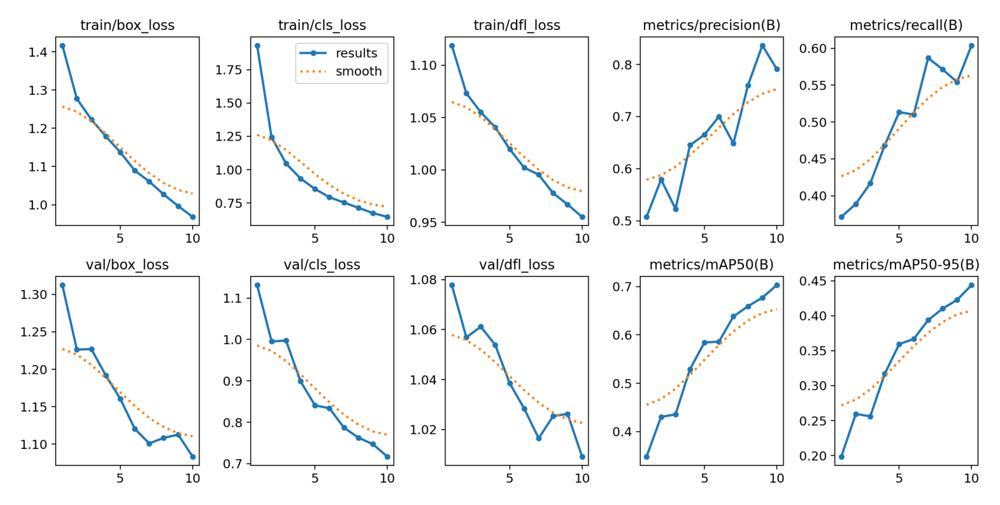

In [32]:
# Results
plt.figure(figsize = (20,20))
plt.imshow(Image.open('/kaggle/working/yolov8n-kitti/train2/results.png'))
plt.axis('off')
plt.show()

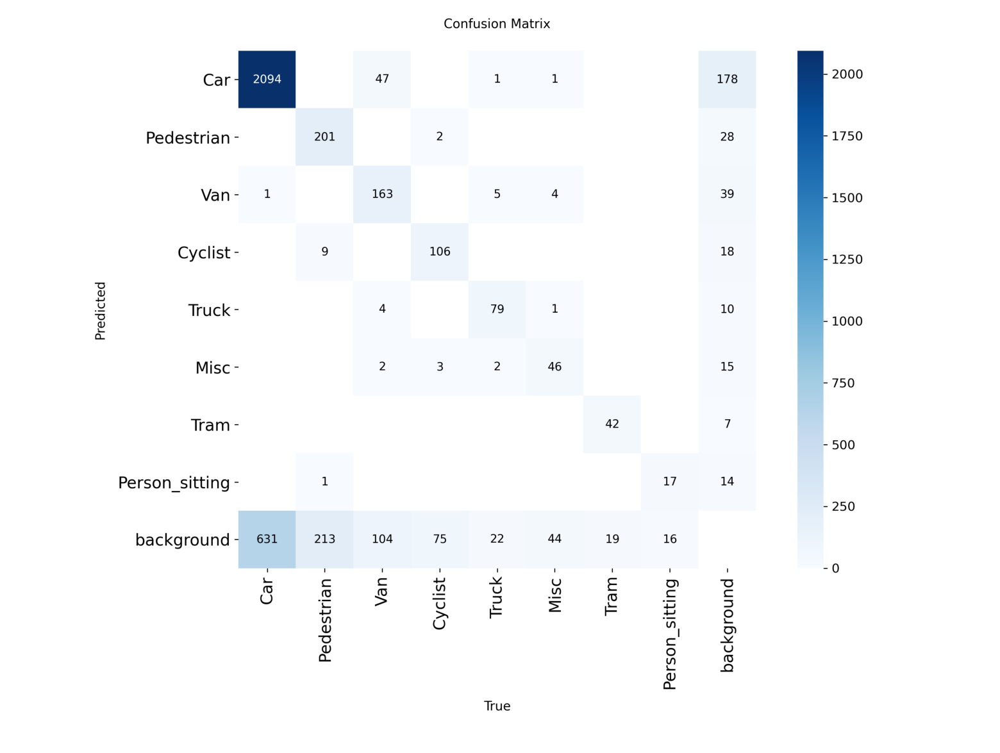

In [38]:
# Results
plt.figure(figsize = (20, 15))
plt.imshow(Image.open('/kaggle/working/yolov8n-kitti/train2/confusion_matrix.png'), cmap = 'Blues')
plt.axis('off')
plt.show()

In [49]:
predict = model.predict([test[i][0] for i in np.random.randint(0, len(test), (15,))], save = True)


0: 640x640 12 Cars, 1 Van, 1 Misc, 4.5ms
1: 640x640 3 Cars, 1 Van, 4.5ms
2: 640x640 9 Cars, 1 Pedestrian, 4.5ms
3: 640x640 1 Pedestrian, 4.5ms
4: 640x640 2 Cars, 3 Pedestrians, 1 Van, 4.5ms
5: 640x640 1 Car, 4.5ms
6: 640x640 4 Pedestrians, 1 Cyclist, 4.5ms
7: 640x640 9 Cars, 1 Van, 4.5ms
8: 640x640 2 Cars, 4.5ms
9: 640x640 2 Cars, 1 Van, 1 Misc, 4.5ms
10: 640x640 3 Cars, 1 Van, 1 Truck, 1 Misc, 4.5ms
11: 640x640 1 Car, 4.5ms
12: 640x640 5 Cars, 1 Truck, 4.5ms
13: 640x640 8 Trams, 18 Person_sittings, 4.5ms
14: 640x640 2 Cars, 4.5ms
Speed: 2.2ms preprocess, 4.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to yolov8n-kitti/train23


In [50]:
test_im_path = list(Path('/kaggle/working/yolov8n-kitti/train23').glob('*'))

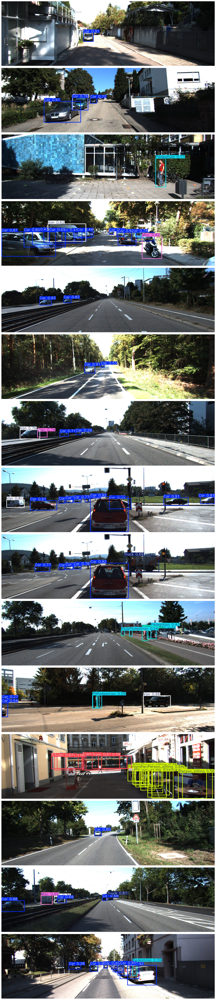

In [63]:
fig, ax = plt.subplots(15, 1, figsize = (25,70))
for i in range(len(test_im_path)) :
    ax[i].imshow(Image.open(test_im_path[i]))
    ax[i].axis('off')
plt.tight_layout()
plt.show()